In [1]:
# Based on: https://www.kaggle.com/code/luischavarriazamora/vtti-yolov8-traffic-sign-detection/notebook

#/kaggle/input/cr-trafficsigns/other/default/1/runs/detect/train/weights/best.pt

# Install Essential Libraries
!pip install ultralytics
!pip install -U ray[tune]
!pip install numpy
!pip install pyyaml

# Import Essential Libraries
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')
import yaml
import shutil

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 32.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 11.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 12.7 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existing ins


image 1/1 /kaggle/input/irl-signs-cr/trim/desvio_ceda.PNG: 448x512 1 RG_ceda, 100.7ms
Speed: 1.6ms preprocess, 100.7ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 512)


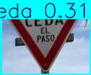


image 1/1 /kaggle/input/irl-signs-cr/trim/alto.PNG: 512x384 1 RG_ALTO, 88.6ms
Speed: 1.7ms preprocess, 88.6ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 384)


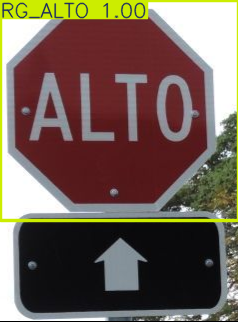


image 1/1 /kaggle/input/irl-signs-cr/trim/trabajos_calle.PNG: 512x512 1 RG_camiones_derecha, 113.4ms
Speed: 2.8ms preprocess, 113.4ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 512)


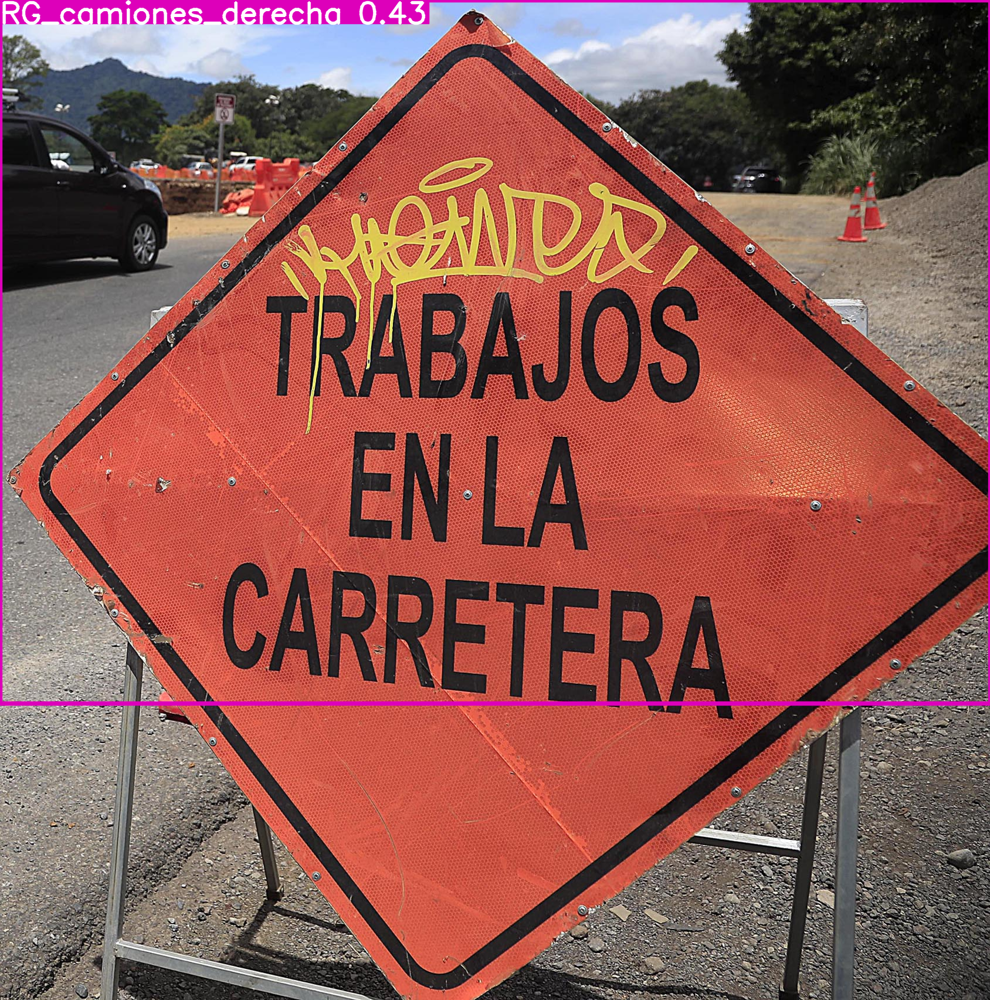


image 1/1 /kaggle/input/irl-signs-cr/trim/ceda_mini2.PNG: 512x352 (no detections), 84.7ms
Speed: 2.2ms preprocess, 84.7ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 352)



image 1/1 /kaggle/input/irl-signs-cr/trim/desvio_ceda3.PNG: 512x352 (no detections), 87.2ms
Speed: 1.4ms preprocess, 87.2ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 352)


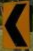


image 1/1 /kaggle/input/irl-signs-cr/trim/curva_adelante.PNG: 512x512 (no detections), 114.9ms
Speed: 2.3ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)


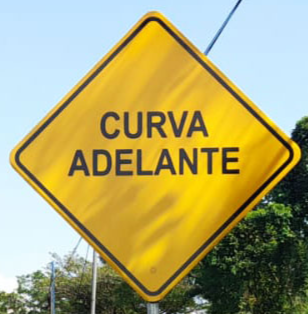


image 1/1 /kaggle/input/irl-signs-cr/trim/ceda.PNG: 448x512 1 RG_ceda, 100.8ms
Speed: 1.8ms preprocess, 100.8ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 512)


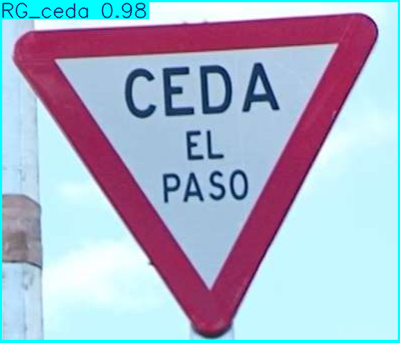


image 1/1 /kaggle/input/irl-signs-cr/trim/no_virar_u.PNG: 512x352 1 RG_no_virar_u, 83.2ms
Speed: 2.1ms preprocess, 83.2ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 352)


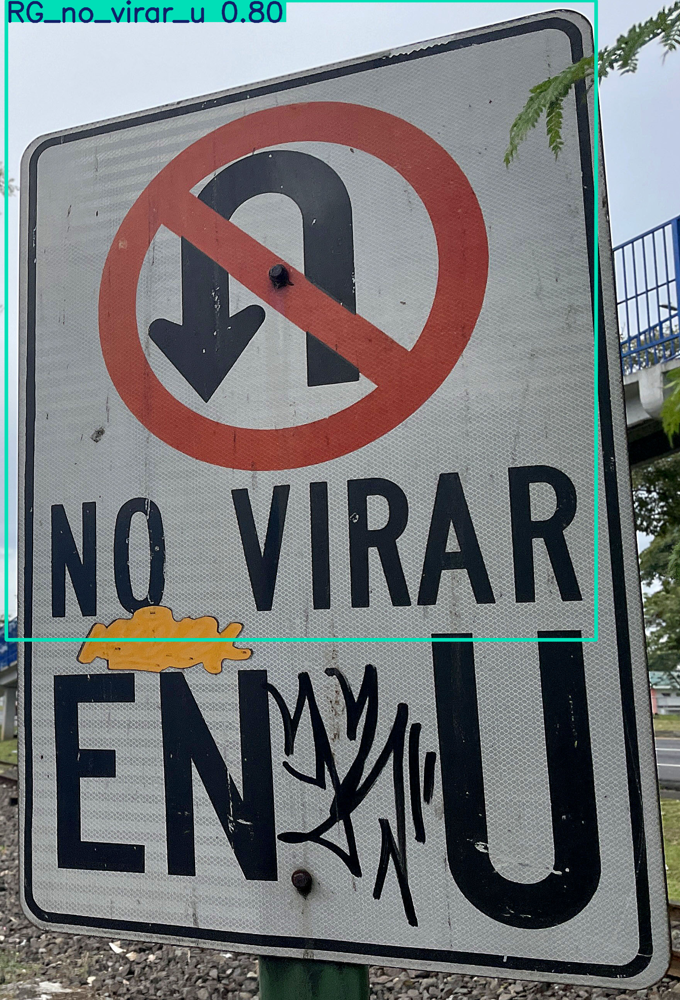


image 1/1 /kaggle/input/irl-signs-cr/trim/ceda_no_estacione2.PNG: 512x352 1 RG_no_estacionar, 83.6ms
Speed: 1.9ms preprocess, 83.6ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 352)


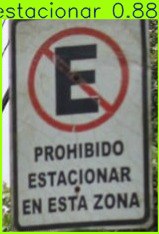


image 1/1 /kaggle/input/irl-signs-cr/trim/desvio_ceda2.PNG: 512x416 (no detections), 94.3ms
Speed: 1.5ms preprocess, 94.3ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 416)


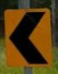


image 1/1 /kaggle/input/irl-signs-cr/trim/buses.png: 512x384 1 RG_parada_buses, 87.5ms
Speed: 1.7ms preprocess, 87.5ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 384)


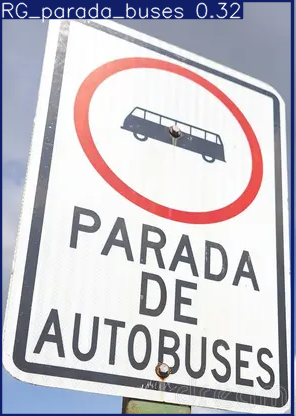


image 1/1 /kaggle/input/irl-signs-cr/trim/peatones.png: 512x480 (no detections), 94.1ms
Speed: 1.7ms preprocess, 94.1ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 480)


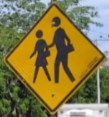


image 1/1 /kaggle/input/irl-signs-cr/trim/zona_escolar1.PNG: 288x512 1 PR_zona_escolar, 64.5ms
Speed: 1.1ms preprocess, 64.5ms inference, 1.0ms postprocess per image at shape (1, 3, 288, 512)


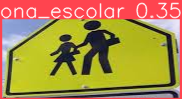


image 1/1 /kaggle/input/irl-signs-cr/trim/alto_esc.PNG: 512x416 (no detections), 88.7ms
Speed: 1.5ms preprocess, 88.7ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 416)


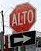


image 1/1 /kaggle/input/irl-signs-cr/trim/ceda_mini.PNG: 480x512 1 OB_Carretera_construccion_adelante, 95.4ms
Speed: 1.6ms preprocess, 95.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 512)


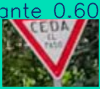


image 1/1 /kaggle/input/irl-signs-cr/trim/desvio_ceda4.PNG: 512x352 (no detections), 72.6ms
Speed: 1.3ms preprocess, 72.6ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 352)


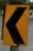


image 1/1 /kaggle/input/irl-signs-cr/trim/max_speed60.PNG: 512x384 (no detections), 80.0ms
Speed: 1.3ms preprocess, 80.0ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 384)


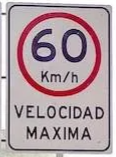


image 1/1 /kaggle/input/irl-signs-cr/trim/ceda_no_estacione.PNG: 480x512 1 RG_ceda, 95.0ms
Speed: 1.8ms preprocess, 95.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 512)


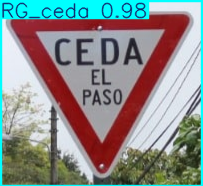


image 1/1 /kaggle/input/irl-signs-cr/trim/sinuosa.PNG: 512x512 1 PR_carretera_sinuosa, 1 PR_carretera_sinuosa_contra, 100.9ms
Speed: 1.6ms preprocess, 100.9ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 512)


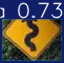

In [13]:
# Use a pretrained YOLOv8n model
#model = YOLO("/kaggle/input/cr-trafficsigns/other/default/1/runs/detect/train/weights/best.pt") 

#model = YOLO("/kaggle/input/cr-trafficsigns-mini/other/default/1/runs/detect/train/weights/best.pt")

model = YOLO("/kaggle/input/cr-signs-21/other/default/1/export_model_2_1/runs/detect/train2/weights/best.pt")


# Use the model to detect object
#result_predict = model.predict(source = image, imgsz=(416))

cropped_image_dir  = '/kaggle/input/irl-signs-cr/trim/'
list_cropped_image = os.listdir(cropped_image_dir)

for studied_image in list_cropped_image:
    if(not(studied_image.endswith('.txt'))):
        image_name     = cropped_image_dir + studied_image
        result_predict = model.predict(source = image_name)

        # show results
        plot = result_predict[0].plot()
        plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
        display(Image.fromarray(plot))

#print(result_predict)

#img     = cv2.imread(image)
#results = model(img
#for *xyxy, conf, cls in results.xyxy[0]:
#    print(f"Class: {results.names[int(cls)]}, Confidence: {conf:.2f}, BBox: {xyxy}")


0: 512x512 (no detections), 113.3ms
Speed: 3.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 RG_ALTO, 109.6ms
Speed: 1.5ms preprocess, 109.6ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 111.2ms
Speed: 1.6ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 112.7ms
Speed: 1.5ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 112.1ms
Speed: 1.6ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 112.4ms
Speed: 1.8ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 112.7ms
Speed: 2.3ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 (no detections), 110.4ms
Speed: 1.5ms preprocess,

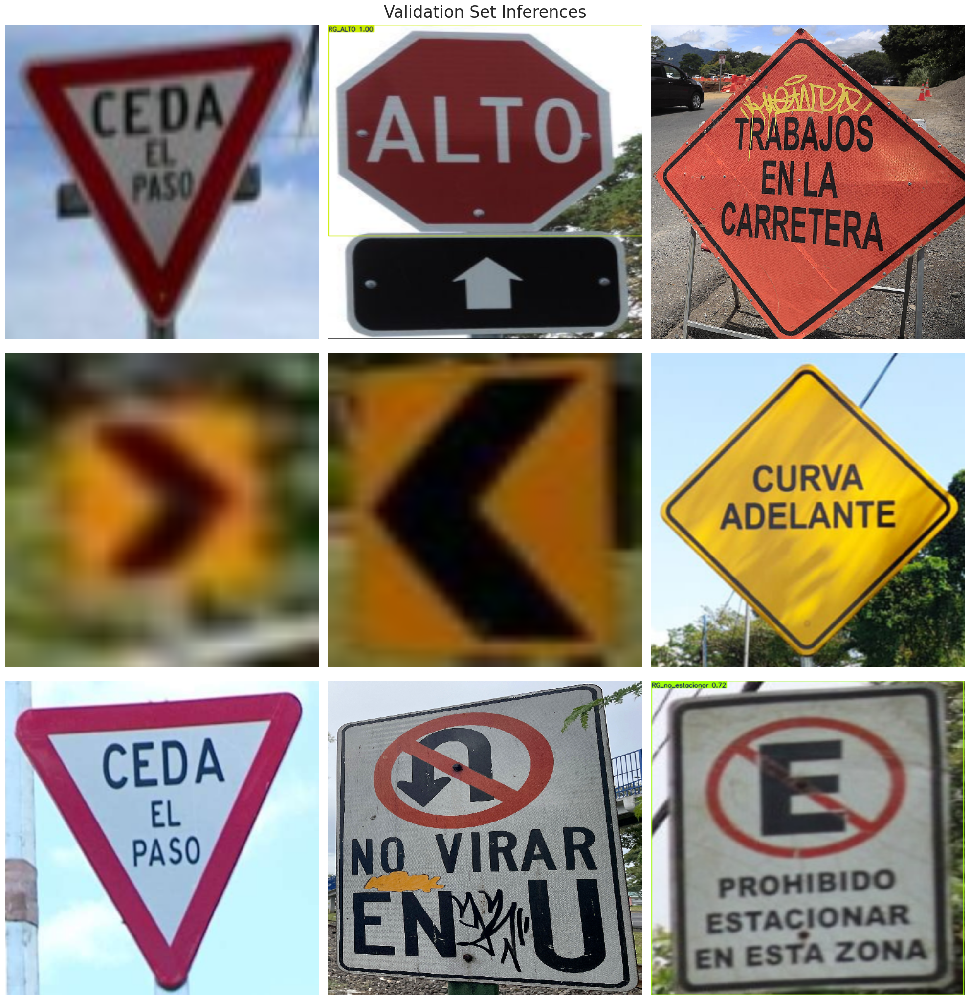

In [14]:
Valid_model=model
# Normalization function
def normalize_image(image):
    return image / 255.0

# Image resizing function
def resize_image(image, size=(416, 416)):
    return cv2.resize(image, size)

# Path to validation images
dataset_path = '/kaggle/input/irl-signs-cr/trim/'  # Place your dataset path here
valid_images_path = dataset_path
#valid_images_path = os.path.join(dataset_path, 'test', 'images')

# List of all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.PNG')]

# Check if there are images in the directory
if len(image_files) > 0:
    # Select 9 images at equal intervals
    num_images = len(image_files)
    step_size = max(1, num_images // 9)  # Ensure the interval is at least 1
    selected_images = [image_files[i] for i in range(0, num_images, step_size)]

    # Prepare subplots
    fig, axes = plt.subplots(3, 3, figsize=(20, 21))
    fig.suptitle('Validation Set Inferences', fontsize=24)

    for i, ax in enumerate(axes.flatten()):
        if i < len(selected_images):
            image_path = os.path.join(valid_images_path, selected_images[i])
            
            # Load image
            image = cv2.imread(image_path)
            
            # Check if the image is loaded correctly
            if image is not None:
                # Resize image
                resized_image = resize_image(image, size=(512, 512))
                # Normalize image
                #normalized_image = normalize_image(image)
                normalized_image = normalize_image(resized_image)
                
                # Convert the normalized image to uint8 data type
                normalized_image_uint8 = (normalized_image * 255).astype(np.uint8)
                
                # Predict with the model
                results = Valid_model.predict(source=normalized_image_uint8, imgsz=512, conf=0.5, iou=0.7)
                
                # Plot image with labels
                annotated_image = results[0].plot(line_width=1)
                annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
                ax.imshow(annotated_image_rgb)
            else:
                print(f"Failed to load image {image_path}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()